In [1]:
import numpy as np
import pandas as pd
from pathlib import Path
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from fetch_api import entsoe_api, energinet_api
from sklearn.metrics import mean_absolute_error, mean_squared_error, root_mean_squared_error
from sklearn.model_selection import TimeSeriesSplit, cross_val_score, train_test_split

%load_ext autoreload

In [2]:
start_date = '2025-03-10'
end_date = '2025-03-15'

Power System Right Now

In [3]:
powersystemrightnow = energinet_api('PowerSystemRightNow', start_date, end_date)
if powersystemrightnow.empty:
    print(f'No data from this period {start_date} to {end_date}')
else:
    powersystemrightnow = powersystemrightnow[['Minutes1UTC','Minutes1DK','aFRR_ActivatedDK1','aFRR_ActivatedDK2']]
    powersystemrightnow['Minutes1UTC'] = pd.to_datetime(powersystemrightnow['Minutes1UTC'])
    powersystemrightnow = powersystemrightnow.rename(columns={'Minutes1UTC':'MinuteUTC'})

aFRR, Automatic Frequency Restoration Reserves, Capacity Market

In [ ]:
aFRRcapacitymarket = energinet_api('AfrrReservesNordic', start_date, end_date)
if aFRRcapacitymarket.empty:
    print(f'No data from this period {start_date} to {end_date}')
else:
    aFRRcapacitymarket = aFRRcapacitymarket.loc[aFRRcapacitymarket['PriceArea'] == 'DK1']
    aFRRcapacitymarket['HourUTC'] = pd.to_datetime(aFRRcapacitymarket['HourUTC'])
    aFRRcapacitymarket = aFRRcapacitymarket.reset_index(drop = True)

aFRR, Automatic Frequency Restoration Reserve, Energy Activated

In [3]:
aFRRenergymarket = energinet_api('AfrrEnergyActivated', start_date, end_date)
if aFRRenergymarket.empty:
    print(f'No data from this period {start_date} to {end_date}')
else:
    aFRRenergymarket = aFRRenergymarket.loc[aFRRenergymarket['PriceArea'] == 'DK1']
    aFRRenergymarket['ActivationTime'] = pd.to_datetime(aFRRenergymarket['ActivationTime'])
    aFRRenergymarket = aFRRenergymarket.rename(columns={'ActivationTime':'SecondUTC'})
    aFRRenergymarket = aFRRenergymarket.reset_index(drop = True)

Elspot Prices

In [4]:
spotprices = energinet_api('Elspotprices', start_date, end_date)
if spotprices.empty:
    print(f'No data from this period {start_date} to {end_date}')
else:
    spotprices = spotprices.loc[spotprices['PriceArea'] == 'DK1']
    spotprices['HourUTC'] = pd.to_datetime(spotprices['HourUTC'])
    spotprices = spotprices.reset_index(drop = True)

Visualize the data

In [4]:
def plot_plotly(df, x_col, y_cols, title, y2_cols=None, y_range=None, y2_range=None):
    fig = go.Figure()

    # Add traces for primary y-axis
    for col in y_cols:
        fig.add_trace(go.Scatter(x=df[x_col], y=df[col], mode='lines', name=col))
    
    # Add traces for secondary y-axis (if provided)
    if y2_cols:
        for col in y2_cols:
            fig.add_trace(go.Scatter(x=df[x_col], y=df[col], mode='lines', name=col, yaxis='y2'))
    
    # Layout settings
    fig.update_layout(
        title=title,
        xaxis=dict(title=x_col, showgrid=True),
        yaxis=dict(title=", ".join(y_cols), range=y_range, showgrid=True),
        yaxis2=dict(
            title=", ".join(y2_cols) if y2_cols else "Secondary Axis",
            overlaying="y",
            side="right",
            range=y2_range
        ),
        template="plotly_white"
    )
    
    fig.show()

In [ ]:
plot_plotly(aFRRcapacitymarket, x_col='HourUTC', y_cols= ['aFRR_DownPurchased','aFRR_UpPurchased'], title = 'Capacity Market MW and Eur', y2_cols= ['aFRR_DownCapPriceEUR', 'aFRR_UpCapPriceEUR'], y_range= [0,120])

In [ ]:
plot_plotly(powersystemrightnow, x_col='MinuteUTC', y_cols= ['aFRR_ActivatedDK1'], title = 'Power system right now Activation')

In [5]:
plot_plotly(aFRRenergymarket, x_col='SecondUTC', y_cols= ['aFRR_DownActivatedPriceEUR','aFRR_UpActivatedPriceEUR'], title = 'Energy Market Up and Down Activation prices')

In [ ]:
temp = pd.merge_asof(aFRRenergymarket.sort_values('SecondUTC'),
                     spotprices.sort_values('HourUTC'),
                     left_on = 'SecondUTC',
                     right_on = 'HourUTC',
                     direction = 'backward')

plot_plotly(temp, x_col='SecondUTC', y_cols= ['aFRR_DownActivatedPriceEUR','aFRR_UpActivatedPriceEUR'], title = 'Energy Market Activation prices and Spot price', y2_cols= ['SpotPriceEUR'])

In [ ]:
temp = pd.merge_asof(powersystemrightnow.sort_values('MinuteUTC'),
                     aFRRcapacitymarket.sort_values('HourUTC'),
                     left_on = 'MinuteUTC',
                     right_on = 'HourUTC',
                     direction = 'backward')
plot_plotly(temp, x_col='MinuteUTC', y_cols= ['aFRR_ActivatedDK1','aFRR_DownPurchased', 'aFRR_UpPurchased'], title = 'Capacity Market MW and aFRR activated')

In [ ]:
temp = pd.merge_asof(aFRRenergymarket.sort_values('SecondUTC'),
                     aFRRcapacitymarket.sort_values('HourUTC'),
                     left_on = 'SecondUTC',
                     right_on = 'HourUTC',
                     direction = 'backward')
plot_plotly(temp, x_col='SecondUTC', y_cols= ['aFRR_DownActivatedPriceEUR','aFRR_UpActivatedPriceEUR','aFRR_DownCapPriceEUR', 'aFRR_UpCapPriceEUR'], title = 'Capacity Market Price vs Energy market price')

Energy Market Activation Price and Spot price correlation

In [8]:
temp = pd.merge_asof(aFRRenergymarket.sort_values('SecondUTC'),
                     spotprices.sort_values('HourUTC'),
                     left_on = 'SecondUTC',
                     right_on = 'HourUTC', 
                     direction = 'backward')
temp = pd.merge_asof(temp.sort_values('SecondUTC'),
                     aFRRcapacitymarket.sort_values('HourUTC'),
                     left_on = 'SecondUTC',
                     right_on = 'HourUTC',
                     direction = 'backward')
temp = pd.merge_asof(temp.sort_values('SecondUTC'),
                     powersystemrightnow.sort_values('MinuteUTC'),
                     left_on = 'SecondUTC',
                     right_on = 'MinuteUTC',
                     direction = 'backward')

In [ ]:
# minute average over a day
temp['Minuteoftheday'] =temp['SecondUTC'].dt.minute  + temp['SecondUTC'].dt.hour * 60
daily_price_trend_on_min_avg = temp.groupby('Minuteoftheday')[['aFRR_DownActivatedPriceEUR','aFRR_UpActivatedPriceEUR', 'SpotPriceEUR','aFRR_DownCapPriceEUR', 'aFRR_UpCapPriceEUR']].mean().reset_index()
# plot_plotly(daily_price_trend_on_min_avg, x_col='Minuteoftheday', y_cols= ['aFRR_DownActivatedPriceEUR','aFRR_UpActivatedPriceEUR'], title= 'Trend of price over a day', y2_cols= ['SpotPriceEUR'])

In [ ]:
# normalise the price to plot for daily trends Min-Max Norm
daily_price_trend_on_min_avg['Nom_spotprice'] = (daily_price_trend_on_min_avg['SpotPriceEUR'] - daily_price_trend_on_min_avg['SpotPriceEUR'].min())/(daily_price_trend_on_min_avg['SpotPriceEUR'].max() - daily_price_trend_on_min_avg['SpotPriceEUR'].min())
daily_price_trend_on_min_avg['Nom_aFRR_DownActivatedPriceEUR'] = (daily_price_trend_on_min_avg['aFRR_DownActivatedPriceEUR'] - daily_price_trend_on_min_avg['aFRR_DownActivatedPriceEUR'].min())/(daily_price_trend_on_min_avg['aFRR_DownActivatedPriceEUR'].max() - daily_price_trend_on_min_avg['aFRR_DownActivatedPriceEUR'].min())
daily_price_trend_on_min_avg['Nom_aFRR_UpActivatedPriceEUR'] = (daily_price_trend_on_min_avg['aFRR_UpActivatedPriceEUR'] - daily_price_trend_on_min_avg['aFRR_UpActivatedPriceEUR'].min())/(daily_price_trend_on_min_avg['aFRR_UpActivatedPriceEUR'].max() - daily_price_trend_on_min_avg['aFRR_UpActivatedPriceEUR'].min())
daily_price_trend_on_min_avg['Nom_aFRR_DownCapPriceEUR'] = (daily_price_trend_on_min_avg['aFRR_DownCapPriceEUR'] - daily_price_trend_on_min_avg['aFRR_DownCapPriceEUR'].min())/(daily_price_trend_on_min_avg['aFRR_DownCapPriceEUR'].max() - daily_price_trend_on_min_avg['aFRR_DownCapPriceEUR'].min())
daily_price_trend_on_min_avg['Nom_aFRR_UpCapPriceEUR'] = (daily_price_trend_on_min_avg['aFRR_UpCapPriceEUR'] - daily_price_trend_on_min_avg['aFRR_UpCapPriceEUR'].min())/(daily_price_trend_on_min_avg['aFRR_UpCapPriceEUR'].max() - daily_price_trend_on_min_avg['aFRR_UpCapPriceEUR'].min())

In [ ]:
# normalise the price to plot for daily trends Z-norm
daily_price_trend_on_min_avg['Nom_spotprice'] = (daily_price_trend_on_min_avg['SpotPriceEUR'] - daily_price_trend_on_min_avg['SpotPriceEUR'].mean())/daily_price_trend_on_min_avg['SpotPriceEUR'].std()
daily_price_trend_on_min_avg['Nom_aFRR_DownActivatedPriceEUR'] = (daily_price_trend_on_min_avg['aFRR_DownActivatedPriceEUR'] - daily_price_trend_on_min_avg['aFRR_DownActivatedPriceEUR'].mean())/daily_price_trend_on_min_avg['aFRR_DownActivatedPriceEUR'].std()
daily_price_trend_on_min_avg['Nom_aFRR_UpActivatedPriceEUR'] = (daily_price_trend_on_min_avg['aFRR_UpActivatedPriceEUR'] - daily_price_trend_on_min_avg['aFRR_UpActivatedPriceEUR'].mean())/daily_price_trend_on_min_avg['aFRR_UpActivatedPriceEUR'].std()
daily_price_trend_on_min_avg['Nom_aFRR_DownCapPriceEUR'] = (daily_price_trend_on_min_avg['aFRR_DownCapPriceEUR'] - daily_price_trend_on_min_avg['aFRR_DownCapPriceEUR'].mean())/daily_price_trend_on_min_avg['aFRR_DownCapPriceEUR'].std()
daily_price_trend_on_min_avg['Nom_aFRR_UpCapPriceEUR'] = (daily_price_trend_on_min_avg['aFRR_UpCapPriceEUR'] - daily_price_trend_on_min_avg['aFRR_UpCapPriceEUR'].mean())/daily_price_trend_on_min_avg['aFRR_UpCapPriceEUR'].std()

In [ ]:
plot_plotly(daily_price_trend_on_min_avg, x_col='Minuteoftheday', y_cols= ['Nom_aFRR_DownActivatedPriceEUR','Nom_aFRR_UpActivatedPriceEUR','Nom_spotprice','Nom_aFRR_DownCapPriceEUR','Nom_aFRR_UpCapPriceEUR'], title= 'Trend of price over a day')

Use spot price and Capacity price as features in LR to predict Activation price

In [9]:
temp['MinuteUTC'] = temp['SecondUTC'].dt.floor('T')
minute_avg_prices = temp.groupby('MinuteUTC')[['aFRR_DownActivatedPriceEUR','aFRR_UpActivatedPriceEUR', 'SpotPriceEUR','aFRR_DownCapPriceEUR', 'aFRR_UpCapPriceEUR','aFRR_ActivatedDK1']].mean().reset_index()
minute_avg_prices.reset_index()
# take mean of activation prices on minute level
minute_avg_prices['UP_activation'] = minute_avg_prices['aFRR_UpActivatedPriceEUR'].notna().astype(int) # Binary Feature - Activation ON/OFF
minute_avg_prices['aFRR_UpActivatedPriceEUR'] = minute_avg_prices['aFRR_UpActivatedPriceEUR'].fillna(0) 

# minute_avg_prices['UpActivation_5mlag'] = minute_avg_prices['aFRR_UpActivatedPriceEUR'].shift(-5)   # 5 m lag Activation Price 
# minute_avg_prices['UpActivation_5mlag'].fillna(minute_avg_prices['aFRR_UpActivatedPriceEUR'].iloc[-1], inplace=True)

minute_avg_prices['UpActivation_1hrlag'] = minute_avg_prices['aFRR_UpActivatedPriceEUR'].shift(-60) # 1 hr lag Activation Price
minute_avg_prices['UpActivation_1hrlag'].fillna(minute_avg_prices['aFRR_UpActivatedPriceEUR'].iloc[-1], inplace=True)

minute_avg_prices['UpActivation_2hrlag'] = minute_avg_prices['aFRR_UpActivatedPriceEUR'].shift(-120) # 2 hr lag Activation Price
minute_avg_prices['UpActivation_2hrlag'].fillna(minute_avg_prices['aFRR_UpActivatedPriceEUR'].iloc[-1], inplace=True)

minute_avg_prices['UPactivation_price_ma2hr'] = minute_avg_prices['UpActivation_1hrlag'].rolling(120, min_periods=1).mean()  # 2-hour rolling avg on 1 hr lag Activation prices
minute_avg_prices['UPactivation_price_ma1hr'] = minute_avg_prices['UpActivation_1hrlag'].rolling(60, min_periods=1).mean()  # 1-hour avg

minute_avg_prices['aFRR_ActivatedDK1_UP_1hrlag'] = minute_avg_prices['aFRR_ActivatedDK1'].shift(-60)
minute_avg_prices['aFRR_ActivatedDK1_UP_1hrlag'].fillna(minute_avg_prices['aFRR_ActivatedDK1'].iloc[-1], inplace=True)


C:\Users\manis\AppData\Local\Temp\ipykernel_30728\2523688203.py:1: FutureWarning: 'T' is deprecated and will be removed in a future version, please use 'min' instead.
  temp['MinuteUTC'] = temp['SecondUTC'].dt.floor('T')
C:\Users\manis\AppData\Local\Temp\ipykernel_30728\2523688203.py:12: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  minute_avg_prices['UpActivation_1hrlag'].fillna(minute_avg_prices['aFRR_UpActivatedPriceEUR'].iloc[-1], inplace=True)
C:\Users\manis\AppData\Local\Temp\ipykernel_30728\2523688203.py:15: FutureWarni

In [ ]:
# introduce some non linear features and check error metrics

In [10]:
features = ['SpotPriceEUR', 'aFRR_ActivatedDK1_UP_1hrlag', 'aFRR_UpCapPriceEUR','UPactivation_price_ma2hr', 'UPactivation_price_ma1hr', 'UpActivation_2hrlag','UpActivation_1hrlag','UP_activation']
X = minute_avg_prices[features]
y = minute_avg_prices['aFRR_UpActivatedPriceEUR']
# up direction

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=False)

In [ ]:
# linear regression

from sklearn.linear_model import LinearRegression

model = LinearRegression()
model.fit(X_train, y_train)

y_pred = model.predict(X_test)
print("MAE:", mean_absolute_error(y_test, y_pred))
print("MSE:", mean_squared_error(y_test, y_pred))

In [11]:
from sklearn.ensemble import RandomForestRegressor

rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train)

y_pred_rf_test = rf_model.predict(X_test)
print("MAE:", mean_absolute_error(y_test, y_pred_rf_test))
print("MSE:", mean_squared_error(y_test, y_pred_rf_test))
print("RMSE:", root_mean_squared_error(y_test, y_pred_rf_test))

y_pred_rf_tr = rf_model.predict(X_train)
# k-fold crossvalidation 
tscv = TimeSeriesSplit(n_splits=5)
scores = cross_val_score(rf_model, X_train, y_train, cv=tscv, scoring='r2')
print("Time Series CV R² Scores:", scores)
print("Mean R²:", np.mean(scores))


MAE: 354.9775076991408
MSE: 572458.1219240832
RMSE: 756.609623203461
Time Series CV R² Scores: [0.28984529 0.50353586 0.16080738 0.44712079 0.16871832]
Mean R²: 0.31400552813330107


In [ ]:
# tocheck the default max-depth range for all trees in RF
[(est.get_depth(), est.tree_.max_depth, est.max_depth) for est in rf_model.estimators_]

[(33, 33, None),
 (34, 34, None),
 (41, 41, None),
 (32, 32, None),
 (40, 40, None),
 (33, 33, None),
 (35, 35, None),
 (35, 35, None),
 (34, 34, None),
 (35, 35, None),
 (35, 35, None),
 (37, 37, None),
 (34, 34, None),
 (33, 33, None),
 (32, 32, None),
 (34, 34, None),
 (34, 34, None),
 (33, 33, None),
 (30, 30, None),
 (34, 34, None),
 (37, 37, None),
 (35, 35, None),
 (41, 41, None),
 (33, 33, None),
 (32, 32, None),
 (33, 33, None),
 (36, 36, None),
 (34, 34, None),
 (33, 33, None),
 (34, 34, None),
 (37, 37, None),
 (35, 35, None),
 (34, 34, None),
 (35, 35, None),
 (38, 38, None),
 (37, 37, None),
 (35, 35, None),
 (36, 36, None),
 (32, 32, None),
 (35, 35, None),
 (35, 35, None),
 (30, 30, None),
 (35, 35, None),
 (31, 31, None),
 (33, 33, None),
 (33, 33, None),
 (36, 36, None),
 (36, 36, None),
 (37, 37, None),
 (33, 33, None),
 (34, 34, None),
 (33, 33, None),
 (32, 32, None),
 (37, 37, None),
 (36, 36, None),
 (34, 34, None),
 (36, 36, None),
 (36, 36, None),
 (32, 32, None

In [ ]:
from xgboost import XGBRegressor

xgb_model = XGBRegressor(n_estimators=300, learning_rate=0.01, max_depth=3, subsample = 0.7, colsample_bytree = 0.8)
xgb_model.fit(X_train, y_train)
y_pred_xgb_test = xgb_model.predict(X_test)

print("MAE:", mean_absolute_error(y_test, y_pred_xgb_test))
print("MSE:", mean_squared_error(y_test, y_pred_xgb_test))
print("RMSE:", root_mean_squared_error(y_test, y_pred_xgb_test))
y_pred_xgb_tr = xgb_model.predict(X_train)

MAE: 200.9119820029999
MSE: 286773.9270818267


In [17]:
minute_avg_prices['aFRR_UpActivatedPriceEUR'].var()

220168.19581040717

In [ ]:
from quantile_forest import RandomForestQuantileRegressor
qrf = RandomForestQuantileRegressor(n_estimators=100)

qrf.fit(X_train, y_train)

y_pred_qrf_test = qrf.predict(X_test, quantiles=[0.05, 0.5, 0.95])
# print("MAE:", mean_absolute_error(y_test, y_pred_qrf_test))
# print("MSE:", mean_squared_error(y_test, y_pred_qrf_test))
# print("RMSE:", root_mean_squared_error(y_test, y_pred_qrf_test))

In [ ]:
y_test = y_test.reset_index(drop = True)
fig = go.Figure()

# Add actual values
fig.add_trace(go.Scatter(y=y_test, mode='lines', name='Actual (y_test)', line=dict(color='blue')))

# Add predicted values
# fig.add_trace(go.Scatter(y=y_pred, mode='lines', name='Predicted (y_pred)', line=dict(color='red', dash='dash')))

fig.add_trace(go.Scatter(y=y_pred_rf_test, mode='lines', name='Predicted (y_pred_rf)'))
fig.add_trace(go.Scatter(y=y_pred_xgb_test, mode='lines', name='Predicted (y_pred_xgb)'))
# fig.add_trace(go.Scatter(y=y_pred_qrf_test[:, 0], mode='lines', name='Predicted (y_pred_qrf) 5%'))
# fig.add_trace(go.Scatter(y=y_pred_qrf_test[:, 1], mode='lines', name='Predicted (y_pred_qrf) 50%'))
# fig.add_trace(go.Scatter(y=y_pred_qrf_test[:, 2], mode='lines', name='Predicted (y_pred_qrf) 95%'))

# Layout settings
fig.update_layout(
    title="Actual vs Predicted Activation Prices",
    xaxis_title="Time Steps",
    yaxis_title="Activation Price",
    template="plotly_white",
    legend=dict(x=0, y=1)
)

fig.show()


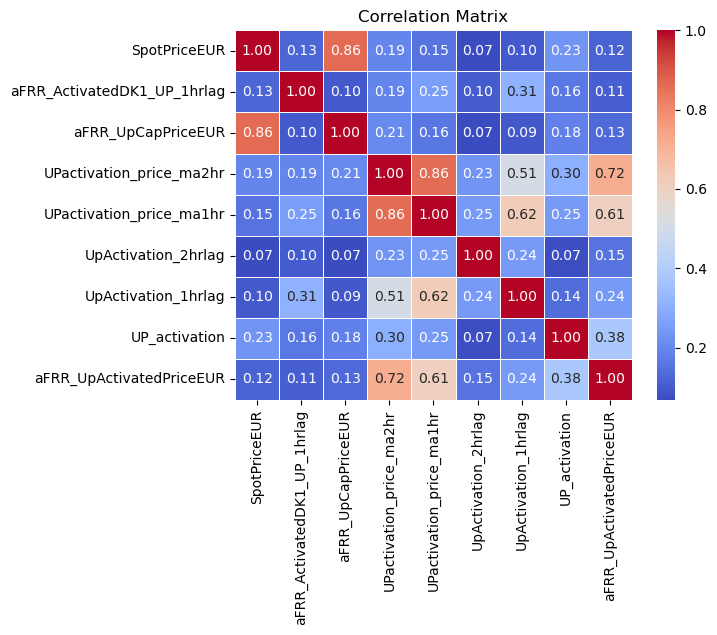

In [14]:
import seaborn as sns


correlation_matrix = minute_avg_prices[features + ['aFRR_UpActivatedPriceEUR']].corr()

# Plot the correlation matrix
plt.figure()
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)
plt.title("Correlation Matrix")
plt.show()


plot normalised daily average of y_pred and y_actual for the whole dataset to see variation of prediction over a day
Z-nom = actual - mean / std

In [15]:
y_pred_whole = np.concatenate([y_pred_rf_tr, y_pred_rf_test])
minute_avg_prices['UP_activation_price_pred_rf'] = y_pred_whole

minute_avg_prices['Minuteoftheday'] =minute_avg_prices['MinuteUTC'].dt.minute  + minute_avg_prices['MinuteUTC'].dt.hour * 60

daily_price_trend_on_min_avg = minute_avg_prices.groupby('Minuteoftheday')[['aFRR_UpActivatedPriceEUR', 'UP_activation_price_pred_rf', 'SpotPriceEUR', 'aFRR_UpCapPriceEUR']].mean().reset_index()
# plot_plotly(daily_price_trend_on_min_avg, x_col='Minuteoftheday', y_cols= ['aFRR_DownActivatedPriceEUR','aFRR_UpActivatedPriceEUR'], title= 'Trend of price over a day', y2_cols= ['SpotPriceEUR'])
# normalise the price to plot for daily trends Z-norm
daily_price_trend_on_min_avg['Nom_spotprice'] = (daily_price_trend_on_min_avg['SpotPriceEUR'] - daily_price_trend_on_min_avg['SpotPriceEUR'].mean())/daily_price_trend_on_min_avg['SpotPriceEUR'].std()
daily_price_trend_on_min_avg['Nom_aFRR_UpActivatedPriceEUR'] = (daily_price_trend_on_min_avg['aFRR_UpActivatedPriceEUR'] - daily_price_trend_on_min_avg['aFRR_UpActivatedPriceEUR'].mean())/daily_price_trend_on_min_avg['aFRR_UpActivatedPriceEUR'].std()
daily_price_trend_on_min_avg['Nom_UP_activation_price_pred_rf'] = (daily_price_trend_on_min_avg['UP_activation_price_pred_rf'] - daily_price_trend_on_min_avg['UP_activation_price_pred_rf'].mean())/daily_price_trend_on_min_avg['UP_activation_price_pred_rf'].std()
daily_price_trend_on_min_avg['Nom_aFRR_UpCapPriceEUR'] = (daily_price_trend_on_min_avg['aFRR_UpCapPriceEUR'] - daily_price_trend_on_min_avg['aFRR_UpCapPriceEUR'].mean())/daily_price_trend_on_min_avg['aFRR_UpCapPriceEUR'].std()
plot_plotly(daily_price_trend_on_min_avg, x_col='Minuteoftheday', y_cols= ['Nom_aFRR_UpActivatedPriceEUR','Nom_UP_activation_price_pred_rf','Nom_spotprice','Nom_aFRR_UpCapPriceEUR'], title= 'Trend of price over a day')

In [16]:
y_pred_whole = np.concatenate([y_pred_xgb_tr, y_pred_xgb_test])
minute_avg_prices['UP_activation_price_pred_xgb'] = y_pred_whole

minute_avg_prices['Minuteoftheday'] =minute_avg_prices['MinuteUTC'].dt.minute  + minute_avg_prices['MinuteUTC'].dt.hour * 60

daily_price_trend_on_min_avg = minute_avg_prices.groupby('Minuteoftheday')[['aFRR_UpActivatedPriceEUR', 'UP_activation_price_pred_xgb', 'SpotPriceEUR', 'aFRR_UpCapPriceEUR']].mean().reset_index()
# plot_plotly(daily_price_trend_on_min_avg, x_col='Minuteoftheday', y_cols= ['aFRR_DownActivatedPriceEUR','aFRR_UpActivatedPriceEUR'], title= 'Trend of price over a day', y2_cols= ['SpotPriceEUR'])
# normalise the price to plot for daily trends Z-norm
daily_price_trend_on_min_avg['Nom_spotprice'] = (daily_price_trend_on_min_avg['SpotPriceEUR'] - daily_price_trend_on_min_avg['SpotPriceEUR'].mean())/daily_price_trend_on_min_avg['SpotPriceEUR'].std()
daily_price_trend_on_min_avg['Nom_aFRR_UpActivatedPriceEUR'] = (daily_price_trend_on_min_avg['aFRR_UpActivatedPriceEUR'] - daily_price_trend_on_min_avg['aFRR_UpActivatedPriceEUR'].mean())/daily_price_trend_on_min_avg['aFRR_UpActivatedPriceEUR'].std()
daily_price_trend_on_min_avg['Nom_UP_activation_price_pred_xgb'] = (daily_price_trend_on_min_avg['UP_activation_price_pred_xgb'] - daily_price_trend_on_min_avg['UP_activation_price_pred_xgb'].mean())/daily_price_trend_on_min_avg['UP_activation_price_pred_xgb'].std()
daily_price_trend_on_min_avg['Nom_aFRR_UpCapPriceEUR'] = (daily_price_trend_on_min_avg['aFRR_UpCapPriceEUR'] - daily_price_trend_on_min_avg['aFRR_UpCapPriceEUR'].mean())/daily_price_trend_on_min_avg['aFRR_UpCapPriceEUR'].std()
plot_plotly(daily_price_trend_on_min_avg, x_col='Minuteoftheday', y_cols= ['Nom_aFRR_UpActivatedPriceEUR','Nom_UP_activation_price_pred_xgb','Nom_spotprice','Nom_aFRR_UpCapPriceEUR'], title= 'Trend of price over a day')

In [46]:
#visualisation of QRF
QRF_test_results = pd.concat([pd.DataFrame(y_test.values, columns = ['y_true']),  pd.DataFrame(y_pred_qrf_test, columns=['y_pred_low', 'y_pred', 'y_pred_upp'])], axis = 1)

Test on present data data

In [ ]:
start_date = '2025-03-01'
end_date = '2025-03-04'
aFRRcapacitymarket = energinet_api('AfrrReservesNordic', start_date, end_date)
if aFRRcapacitymarket.empty:
    print(f'No data from this period {start_date} to {end_date}')
else:
    aFRRcapacitymarket = aFRRcapacitymarket.loc[aFRRcapacitymarket['PriceArea'] == 'DK1']
    aFRRcapacitymarket['HourUTC'] = pd.to_datetime(aFRRcapacitymarket['HourUTC'])
    aFRRcapacitymarket = aFRRcapacitymarket.reset_index(drop = True)

aFRRenergymarket = energinet_api('AfrrEnergyActivated', start_date, end_date)
if aFRRenergymarket.empty:
    print(f'No data from this period {start_date} to {end_date}')
else:
    aFRRenergymarket = aFRRenergymarket.loc[aFRRenergymarket['PriceArea'] == 'DK1']
    aFRRenergymarket['ActivationTime'] = pd.to_datetime(aFRRenergymarket['ActivationTime'])
    aFRRenergymarket = aFRRenergymarket.rename(columns={'ActivationTime':'SecondUTC'})
    aFRRenergymarket = aFRRenergymarket.reset_index(drop = True)

spotprices = energinet_api('Elspotprices', start_date, end_date)
if spotprices.empty:
    print(f'No data from this period {start_date} to {end_date}')
else:
    spotprices = spotprices.loc[spotprices['PriceArea'] == 'DK1']
    spotprices['HourUTC'] = pd.to_datetime(spotprices['HourUTC'])
    spotprices = spotprices.reset_index(drop = True)

In [61]:
temp1 = pd.merge_asof(aFRRenergymarket.sort_values('SecondUTC'),
                     spotprices.sort_values('HourUTC'),
                     left_on = 'SecondUTC',
                     right_on = 'HourUTC', 
                     direction = 'backward')
temp1 = pd.merge_asof(temp1.sort_values('SecondUTC'),
                     aFRRcapacitymarket.sort_values('HourUTC'),
                     left_on = 'SecondUTC',
                     right_on = 'HourUTC',
                     direction = 'backward')
temp1 = pd.merge_asof(temp1.sort_values('SecondUTC'),
                     powersystemrightnow.sort_values('MinuteUTC'),
                     left_on = 'SecondUTC',
                     right_on = 'MinuteUTC',
                     direction = 'backward')

In [62]:
temp1['MinuteUTC'] = temp1['SecondUTC'].dt.floor('T')
present_day = temp1.groupby('MinuteUTC')[['aFRR_DownActivatedPriceEUR','aFRR_UpActivatedPriceEUR', 'SpotPriceEUR','aFRR_DownCapPriceEUR', 'aFRR_UpCapPriceEUR','aFRR_ActivatedDK1']].mean().reset_index()
present_day.reset_index()
# take mean of activation prices on minute level
present_day['UP_activation'] = present_day['aFRR_UpActivatedPriceEUR'].notna().astype(int) # Binary Feature - Activation ON/OFF
present_day['aFRR_UpActivatedPriceEUR'] = present_day['aFRR_UpActivatedPriceEUR'].fillna(0) 

# minute_avg_prices['UpActivation_5mlag'] = minute_avg_prices['aFRR_UpActivatedPriceEUR'].shift(-5)   # 5 m lag Activation Price 
# minute_avg_prices['UpActivation_5mlag'].fillna(minute_avg_prices['aFRR_UpActivatedPriceEUR'].iloc[-1], inplace=True)

present_day['UpActivation_1hrlag'] = present_day['aFRR_UpActivatedPriceEUR'].shift(-60) # 1 hr lag Activation Price
present_day['UpActivation_1hrlag'].fillna(present_day['aFRR_UpActivatedPriceEUR'].iloc[-1], inplace=True)

present_day['UpActivation_2hrlag'] = present_day['aFRR_UpActivatedPriceEUR'].shift(-120) # 2 hr lag Activation Price
present_day['UpActivation_2hrlag'].fillna(present_day['aFRR_UpActivatedPriceEUR'].iloc[-1], inplace=True)

present_day['UPactivation_price_ma2hr'] = present_day['UpActivation_1hrlag'].rolling(120, min_periods=1).mean()  # 2-hour rolling avg on 1 hr lag Activation prices
present_day['UPactivation_price_ma1hr'] = present_day['UpActivation_1hrlag'].rolling(60, min_periods=1).mean()  # 1-hour avg

present_day['aFRR_ActivatedDK1_UP_1hrlag'] = present_day['aFRR_ActivatedDK1'].shift(-60)
present_day['aFRR_ActivatedDK1_UP_1hrlag'].fillna(present_day['aFRR_ActivatedDK1'].iloc[-1], inplace=True)

In [63]:
# features =  ['SpotPriceEUR', 'aFRR_ActivatedDK1_UP_1hrlag', 'aFRR_UpCapPriceEUR','UPactivation_price_ma2hr', 'UPactivation_price_ma1hr', 'UpActivation_2hrlag','UpActivation_1hrlag','UP_activation']
X_test1 = present_day[features]
y_test1 = present_day['aFRR_UpActivatedPriceEUR']

y_pred_rf1 = rf_model.predict(X_test1)
print("MAE:", mean_absolute_error(y_test1, y_pred_rf1))
print("MSE:", mean_squared_error(y_test1, y_pred_rf1))
print("RMSE:", root_mean_squared_error(y_test1, y_pred_rf1))
print('Var:', present_day['aFRR_UpActivatedPriceEUR'].var())

MAE: 36.91334453820757
MSE: 12538.851369938624
RMSE: 111.97701268536602
Var: 18643.516297117993


In [64]:
y_test1 = y_test1.reset_index(drop = True)
fig = go.Figure()

# Add actual values
fig.add_trace(go.Scatter(y=y_test1, mode='lines', name='Actual (y_test)', line=dict(color='blue')))

# Add predicted values
fig.add_trace(go.Scatter(y=y_pred_rf1, mode='lines', name='Predicted (y_pred_rf1)', line=dict(color='red')))

# Layout settings
fig.update_layout(
    title="Actual vs Predicted Activation Prices",
    xaxis_title="Time Steps",
    yaxis_title="Activation Price",
    template="plotly_white",
    legend=dict(x=0, y=1)
)

fig.show()

In [ ]:
present_day['UP_activation_price_pred_rf'] = y_pred_rf1

present_day['Minuteoftheday'] =present_day['MinuteUTC'].dt.minute  + present_day['MinuteUTC'].dt.hour * 60

daily_price_trend_presentday = present_day.groupby('Minuteoftheday')[['aFRR_UpActivatedPriceEUR', 'UP_activation_price_pred_rf', 'SpotPriceEUR', 'aFRR_UpCapPriceEUR']].mean().reset_index()
# plot_plotly(daily_price_trend_on_min_avg, x_col='Minuteoftheday', y_cols= ['aFRR_DownActivatedPriceEUR','aFRR_UpActivatedPriceEUR'], title= 'Trend of price over a day', y2_cols= ['SpotPriceEUR'])
# normalise the price to plot for daily trends Z-norm
daily_price_trend_presentday['Nom_spotprice'] = (daily_price_trend_presentday['SpotPriceEUR'] - daily_price_trend_presentday['SpotPriceEUR'].mean())/daily_price_trend_presentday['SpotPriceEUR'].std()
daily_price_trend_presentday['Nom_aFRR_UpActivatedPriceEUR'] = (daily_price_trend_presentday['aFRR_UpActivatedPriceEUR'] - daily_price_trend_presentday['aFRR_UpActivatedPriceEUR'].min())/(daily_price_trend_presentday['aFRR_UpActivatedPriceEUR'].max() - daily_price_trend_presentday['aFRR_UpActivatedPriceEUR'].min())
daily_price_trend_presentday['Nom_UP_activation_price_pred_rf'] = (daily_price_trend_presentday['UP_activation_price_pred_rf'] - daily_price_trend_presentday['UP_activation_price_pred_rf'].mean())/daily_price_trend_presentday['UP_activation_price_pred_rf'].std()
daily_price_trend_presentday['Nom_aFRR_UpCapPriceEUR'] = (daily_price_trend_presentday['aFRR_UpCapPriceEUR'] - daily_price_trend_presentday['aFRR_UpCapPriceEUR'].mean())/daily_price_trend_presentday['aFRR_UpCapPriceEUR'].std()
plot_plotly(daily_price_trend_presentday, x_col='Minuteoftheday', y_cols= ['Nom_aFRR_UpActivatedPriceEUR','Nom_UP_activation_price_pred_rf','Nom_spotprice','Nom_aFRR_UpCapPriceEUR'], title= 'Trend of price over a day')

Activation rates in DK1

In [2]:
start_date = '2025-03-10'
end_date = '2025-03-15'

In [3]:
aFRRcapacitymarket = energinet_api('AfrrReservesNordic', start_date, end_date)
if aFRRcapacitymarket.empty:
    print(f'No data from this period {start_date} to {end_date}')
else:
    aFRRcapacitymarket = aFRRcapacitymarket.loc[aFRRcapacitymarket['PriceArea'] == 'DK1']
    aFRRcapacitymarket['HourUTC'] = pd.to_datetime(aFRRcapacitymarket['HourUTC'])
    aFRRcapacitymarket = aFRRcapacitymarket.reset_index(drop = True)

In [5]:
ImbalancePrice = energinet_api('ImbalancePrice', start_date, end_date)
if ImbalancePrice.empty:
    print(f'No data from this period {start_date} to {end_date}')
else:
    ImbalancePrice = ImbalancePrice.loc[ImbalancePrice['PriceArea'] == 'DK1']
    ImbalancePrice['TimeUTC'] = pd.to_datetime(ImbalancePrice['TimeUTC'])